# Task: Geospatial Analysis

Visualize the locations of restaurants on a
map using latitude and longitude
information.

Analyze the distribution of restaurants
across different cities or countries.
Determine if there is any correlation
between the restaurant's location and its
rating.

# Step 1: 
Import Libraries and Load the Dataset

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import folium

# Load dataset
df = pd.read_csv(r"C:\Users\HP\Downloads\Dataset_cleaned .csv")

# Clean column names (important!)
df.columns = df.columns.str.strip()

# Step 2: 
Explore the Latitude & Longitude Columns

In [2]:
# Check if 'Latitude' and 'Longitude' columns are present
print(df.columns)

# Preview the coordinates
print(df[['Latitude', 'Longitude']].head())

Index(['Restaurant ID', 'Restaurant Name', 'Country Code', 'City', 'Address',
       'Locality', 'Locality Verbose', 'Longitude', 'Latitude', 'Cuisines',
       'Average Cost for two', 'Currency', 'Has Table booking',
       'Has Online delivery', 'Is delivering now', 'Switch to order menu',
       'Price range', 'Aggregate rating', 'Rating color', 'Rating text',
       'Votes'],
      dtype='object')
    Latitude   Longitude
0  14.565443  121.027535
1  14.553708  121.014101
2  14.581404  121.056831
3  14.585318  121.056475
4  14.584450  121.057508


# Step 3:
Visualize Restaurant Locations on a Map using Folium

In [3]:
# Create a base map (centered around India as an example)
map_restaurants = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

# Plot each restaurant as a point
for index, row in df.iterrows():
    if pd.notnull(row['Latitude']) and pd.notnull(row['Longitude']):
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=2,
            color='red',
            fill=True,
            fill_opacity=0.5
        ).add_to(map_restaurants)

# Display the map
map_restaurants

# Step 4: 
Analyze Restaurant Distribution Across Cities

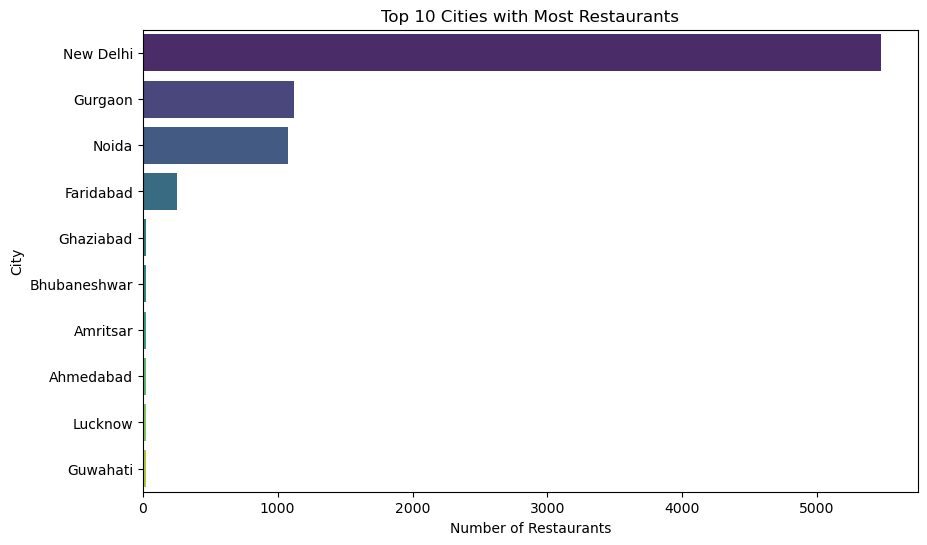

In [4]:
# Count number of restaurants per city
city_counts = df['City'].value_counts()

# Plot top 10 cities
plt.figure(figsize=(10,6))
sns.barplot(x=city_counts.head(10).values, y=city_counts.head(10).index, palette='viridis')
plt.title('Top 10 Cities with Most Restaurants')
plt.xlabel('Number of Restaurants')
plt.ylabel('City')
plt.show()

# Step 5: 
Correlation Between Location and Rating

You can visually explore the relationship between geography and ratings:

🟢 5.1 Add Ratings on the Map (Color-coded)

In [5]:
# Normalize ratings for color scaling
def get_color(rating):
    if rating >= 4.5:
        return 'green'
    elif rating >= 3.5:
        return 'orange'
    else:
        return 'red'

map_ratings = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

for index, row in df.iterrows():
    if pd.notnull(row['Latitude']) and pd.notnull(row['Longitude']) and pd.notnull(row['Aggregate rating']):
        folium.CircleMarker(
            location=[row['Latitude'], row['Longitude']],
            radius=3,
            color=get_color(row['Aggregate rating']),
            fill=True,
            fill_color=get_color(row['Aggregate rating']),
            fill_opacity=0.6,
            popup=f"Rating: {row['Aggregate rating']}"
        ).add_to(map_ratings)

map_ratings

🟢 Green = High Rating, 🟠 Orange = Medium, 🔴 Red = Low

📉 5.2 Average Rating by City

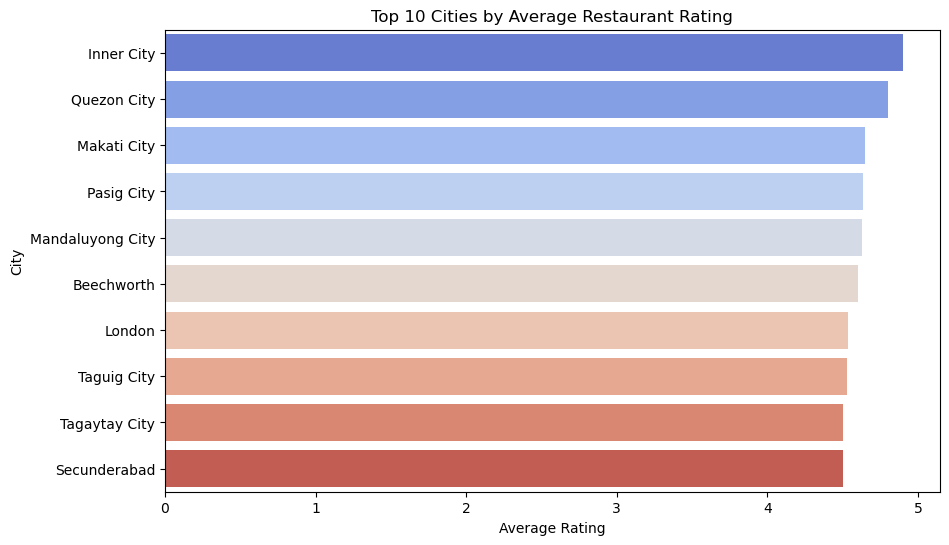

In [6]:
city_rating = df.groupby('City')['Aggregate rating'].mean().sort_values(ascending=False)

# Plot top 10 cities with highest average ratings
plt.figure(figsize=(10,6))
sns.barplot(x=city_rating.head(10).values, y=city_rating.head(10).index, palette='coolwarm')
plt.title('Top 10 Cities by Average Restaurant Rating')
plt.xlabel('Average Rating')
plt.ylabel('City')
plt.show()

# 📌 Summary of Geospatial Analysis

🗺️ Map Restaurant Locations

Used Plotly’s scatter_mapbox to create an interactive map

Plotted restaurants using Latitude and Longitude

Color-coded by Aggregate Rating

🏙️ Distribution by City

Used value_counts() to count restaurants per city

Visualized top cities with a bar plot using Seaborn

📈 Correlation with Rating

Analyzed average rating by city using groupby() and mean()

Visualized using bar chart

Optional: Used a heatmap to check correlation between rating, latitude, and longitude